In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler,LabelEncoder
from sklearn.metrics import mean_absolute_error as mae, mean_squared_error as mse,r2_score
import math
from pycaret.regression import *

from tensorflow import keras

In [3]:
data = pd.read_excel('../data/Processed_data_noZero.xlsx') 
data = data.loc[:, ~data.columns.str.contains('^Unnamed')]
data.head()

,Test Time,Roll Speed,Eng. Speed,CO Mass,NOx Mass,CO2 Mass,driving cycle,Vehicle
0,6.1,0.054110,863.487,3.345830e-10,0.000004,0.327586,Urban-Free,1
1,8.1,0.007586,872.968,4.586630e-09,0.000005,0.326265,Urban-Free,1
2,10.1,0.083947,861.854,3.301040e-10,0.000004,0.323550,Urban-Free,1
3,11.1,0.031859,869.703,3.341100e-10,0.000004,0.327409,Urban-Free,1
4,12.1,0.038939,863.675,2.337160e-09,0.000004,0.333081,Urban-Free,1


In [10]:
exp_reg101 = setup(data = data[['Roll Speed','Eng. Speed','CO Mass','driving cycle ','Vehicle']],
                    target = 'CO Mass', session_id=123)

,Description,Value
0,session_id,123
1,Target,CO Mass
2,Original Data,"(74176, 5)"
3,Missing Values,False
4,Numeric Features,2
5,Categorical Features,2
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(51923, 17)"


In [11]:
best = compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.0081,0.0017,0.0407,0.2554,0.0318,2531.6524,0.0630
gbr,Gradient Boosting Regressor,0.0088,0.0017,0.0415,0.2285,0.0322,5097.9824,0.8950
rf,Random Forest Regressor,0.0080,0.0019,0.0429,0.1716,0.0338,668.0056,2.0600
et,Extra Trees Regressor,0.0082,0.0020,0.0443,0.1145,0.0349,636.3750,1.4200
lr,Linear Regression,0.0131,0.0021,0.0456,0.0672,0.0360,26872.3777,0.0490
ridge,Ridge Regression,0.0131,0.0021,0.0456,0.0672,0.0360,26869.4119,0.0220
lar,Least Angle Regression,0.0131,0.0021,0.0456,0.0672,0.0360,26723.3037,0.0200
br,Bayesian Ridge,0.0131,0.0021,0.0456,0.0672,0.0360,26800.7540,0.0380
omp,Orthogonal Matching Pursuit,0.0106,0.0021,0.0460,0.0512,0.0364,8597.5409,0.0190
en,Elastic Net,0.0118,0.0023,0.0472,-0.0001,0.0376,33834.3275,0.0190


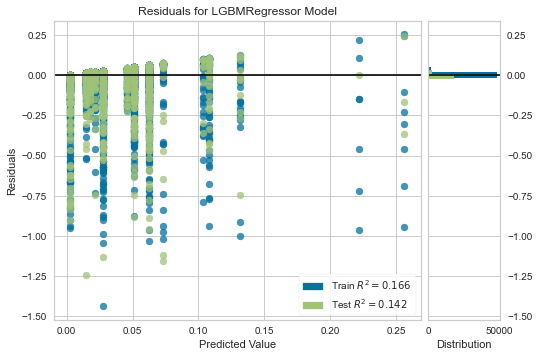

In [17]:
best = tune_model(best)


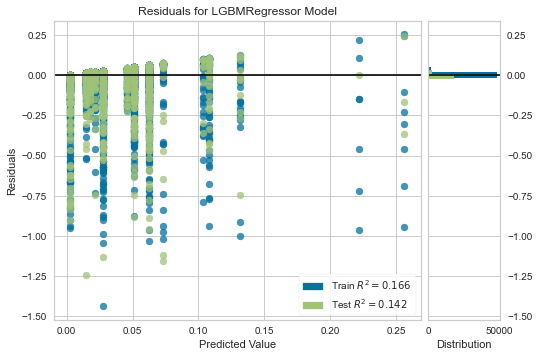

In [18]:
plot_model(best, plot='residuals')

LGBMRegressor(bagging_fraction=0.9, bagging_freq=3, boosting_type='gbdt',
              class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
              importance_type='split', learning_rate=0.4, max_depth=-1,
              min_child_samples=6, min_child_weight=0.001, min_split_gain=0.3,
              n_estimators=20, n_jobs=-1, num_leaves=150, objective=None,
              random_state=123, reg_alpha=0.005, reg_lambda=0.0005, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

In [ ]:
from pycaret.utils import check_metric
check_metric(unseen_predictions.Price, unseen_predictions.Label, 'R2')